# Statistical Thinking for Data Science - Technical Report

In [ ]:
import pandas as pd
import plotly.graph_objects as go
import requests
from bs4 import BeautifulSoup

In [ ]:
df=pd.read_csv('LifeExpectancyDataset3.csv').drop('Unnamed: 0',axis=1)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5107 entries, 0 to 5106
Data columns (total 39 columns):
 #   Column                                                                                    Non-Null Count  Dtype  
---  ------                                                                                    --------------  -----  
 0   Life expectancy                                                                           5107 non-null   float64
 1   Country                                                                                   5107 non-null   object 
 2   Year                                                                                      5107 non-null   int64  
 3   infantMortality                                                                           4975 non-null   float64
 4   Population                                                                                5096 non-null   float64
 5   GDP                                                    

# Attach Developed/Developing

In [ ]:
df_kaggle=pd.read_csv('/Users/savinaysingh/Downloads/Life Expectancy Data (1).csv')

In [ ]:
edit_country_name={
    'United States of America': 'United States',
    'United Kingdom of Great Britain and Northern Ireland': 'United Kingdom',
    'Bolivia (Plurinational State of)': 'Bolivia',
    "Côte d'Ivoire": "Cote d'Ivoire",
    'Swaziland': 'Eswatini',
    'Viet Nam': 'Vietnam'
    
}

In [ ]:
l=[]
for i in df_kaggle['Country']:
    if i in edit_country_name:
        l.append(edit_country_name[i])
    else:
        l.append(i)

In [ ]:
df_kaggle['Country']=l

In [ ]:
country = [x.lower() for x in list(df_kaggle['Country'])]

In [ ]:
status_dict = dict(zip(country,list(df_kaggle['Status'])))

In [ ]:
[0 if l in status_dict else 1 for l in df.Country]

In [ ]:
status = [status_dict[l.lower()] if l.lower() in status_dict else 'Status Not Available' for l in df.Country]

In [ ]:
len(status)

5107

In [ ]:
df['Status']=status

In [ ]:
df[df['Status']=='Status Not Available'].Country.unique()

array(['Bermuda', 'European Union', 'French Polynesia', 'Greenland',
       'Guam', 'Kosovo', 'Middle East & North Africa', 'Moldova',
       'New Caledonia', 'North America', 'North Macedonia', 'Puerto Rico',
       'South Asia', 'Sub-Saharan Africa', 'Tanzania', 'World'],
      dtype=object)

In [ ]:
df[df['Status']=='Status Not Available']

,Life expectancy,Country,Year,infantMortality,Population,GDP,Number of executions (Amnesty International),Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",...,Terrorism (deaths),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number),Status
510,74.029512,Bermuda,1991,NaN,5.902100e+04,27700.31006,NaN,1.0,123.0,0.0,...,NaN,206.0,10.0,11.0,10.0,19.0,0.0,11.0,5.0,Status Not Available
511,77.885366,Bermuda,2000,NaN,6.183300e+04,56284.16865,NaN,0.0,127.0,0.0,...,NaN,173.0,11.0,12.0,7.0,16.0,0.0,15.0,5.0,Status Not Available
512,77.885366,Bermuda,2001,NaN,6.250400e+04,58883.95943,NaN,0.0,127.0,0.0,...,NaN,167.0,11.0,12.0,7.0,16.0,0.0,15.0,5.0,Status Not Available
513,78.087805,Bermuda,2002,NaN,6.291200e+04,62583.10020,NaN,0.0,129.0,0.0,...,NaN,163.0,11.0,12.0,7.0,16.0,0.0,16.0,5.0,Status Not Available
514,78.334146,Bermuda,2003,NaN,6.332500e+04,66111.72523,NaN,0.0,130.0,0.0,...,NaN,160.0,12.0,12.0,7.0,16.0,0.0,16.0,5.0,Status Not Available
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5042,71.952115,World,2015,31.4,7.347679e+09,10231.70259,NaN,267947.0,9138501.0,110255.0,...,38853.0,17099164.0,1287809.0,3692439.0,1385734.0,2405760.0,88786.0,1395701.0,321963.0,Status Not Available
5043,72.186230,World,2016,30.6,7.433651e+09,10286.41133,NaN,261408.0,9341881.0,109936.0,...,34871.0,17408326.0,1325894.0,3742353.0,1404943.0,2441045.0,84761.0,1452620.0,330916.0,Status Not Available
5044,72.391699,World,2017,29.7,7.519371e+09,10825.90237,NaN,250281.0,9534619.0,109262.0,...,26445.0,17695752.0,1352271.0,3797538.0,1426787.0,2479463.0,82507.0,1510447.0,339540.0,Status Not Available
5045,72.574415,World,2018,28.9,7.602716e+09,11366.07367,NaN,241812.0,9797018.0,110739.0,...,NaN,18124018.0,1388601.0,3888249.0,1448499.0,2516671.0,80924.0,1569449.0,351517.0,Status Not Available


In [ ]:
status_update={
 'Bermuda': 'Developing',
    'Greenland': 'Developing',
    'Guam': 'Developing',
    'Moldova': 'Developing',
    'North Macedonia': 'Developing',
    'Puerto Rico': 'Developing',
    'Tanzania': 'Developing'
}

In [ ]:
df=df.reset_index(drop=True)

In [ ]:
stat=[]
for i in range(0,len(df.Country)):
    if df.Country[i] in status_update:
        stat.append(status_update[df.Country[i]])
    else:
        stat.append(df.Status[i])


In [ ]:
df.Status=stat

In [ ]:
df[df['Status']=='Status Not Available'].Country.unique()

array(['European Union', 'French Polynesia', 'Kosovo',
       'Middle East & North Africa', 'New Caledonia', 'North America',
       'South Asia', 'Sub-Saharan Africa', 'World'], dtype=object)

In [ ]:
df=df[df['Status']!='Status Not Available']

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4912 entries, 0 to 5106
Data columns (total 40 columns):
 #   Column                                                                                    Non-Null Count  Dtype  
---  ------                                                                                    --------------  -----  
 0   Life expectancy                                                                           4912 non-null   float64
 1   Country                                                                                   4912 non-null   object 
 2   Year                                                                                      4912 non-null   int64  
 3   infantMortality                                                                           4801 non-null   float64
 4   Population                                                                                4901 non-null   float64
 5   GDP                                                    

# Exploratory Data Analysis

In [ ]:
def get_nan_vals(df):
    nan_vals = dict(sorted(df.isna().sum().to_dict().items(), key=lambda item: item[1], reverse=True))
    return nan_vals

In [ ]:
def plot_nan_vals(X, Y):
    fig = go.Figure(data = go.Bar(x=X, y=Y, marker={"color":[1, 2, 3, 4, 5,6,7]}))
    fig.show()

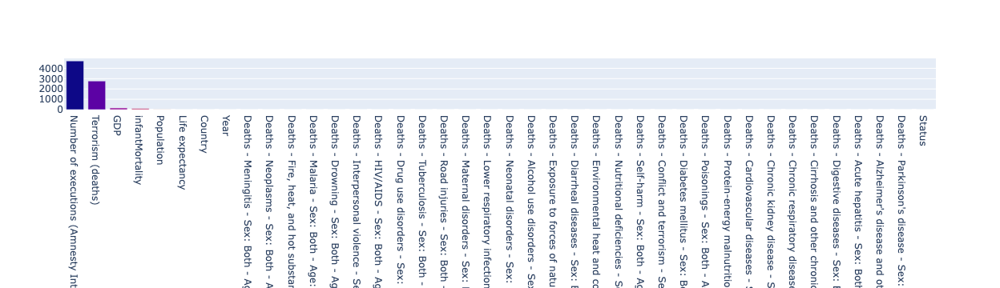

In [ ]:
nan_vals = get_nan_vals(df)
X = list(nan_vals.keys())
Y = list(nan_vals.values())
plot_nan_vals(X,Y)

# Removing the number of executions 

In [ ]:
df=df.drop('Number of executions (Amnesty International)',axis=1)

In [ ]:
df

,Life expectancy,Country,Year,infantMortality,Population,GDP,Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",Deaths - Malaria - Sex: Both - Age: All Ages (Number),...,Terrorism (deaths),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number),Status
0,59.375,Afghanistan,2007,71.9,27100542.0,359.693158,2933.0,15925.0,481.0,393.0,...,1199.0,53962.0,4490.0,7222.0,3346.0,6458.0,3437.0,1402.0,450.0,Developing
1,59.930,Afghanistan,2008,69.2,27722281.0,364.663542,2731.0,16148.0,462.0,255.0,...,1092.0,54051.0,4534.0,7143.0,3316.0,6408.0,3005.0,1424.0,455.0,Developing
2,60.484,Afghanistan,2009,66.7,28394806.0,437.268740,2460.0,16383.0,448.0,239.0,...,1065.0,53964.0,4597.0,7045.0,3291.0,6358.0,2663.0,1449.0,460.0,Developing
3,61.553,Afghanistan,2011,61.8,30117411.0,591.190030,2327.0,17094.0,448.0,390.0,...,1525.0,54347.0,4785.0,6916.0,3318.0,6370.0,2365.0,1508.0,473.0,Developing
4,62.054,Afghanistan,2012,59.5,31161378.0,638.845852,2254.0,17522.0,445.0,94.0,...,3521.0,54868.0,4846.0,6878.0,3353.0,6398.0,2264.0,1544.0,482.0,Developing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5102,59.534,Zimbabwe,2015,42.1,13814642.0,1445.069702,1439.0,11161.0,632.0,2518.0,...,NaN,16649.0,2108.0,2751.0,1956.0,4202.0,146.0,754.0,215.0,Developing
5103,60.294,Zimbabwe,2016,40.8,14030338.0,1464.588957,1457.0,11465.0,648.0,2050.0,...,NaN,16937.0,2160.0,2788.0,1962.0,4264.0,146.0,767.0,219.0,Developing
5104,60.812,Zimbabwe,2017,39.9,14236599.0,1235.189032,1460.0,11744.0,654.0,2116.0,...,0.0,17187.0,2196.0,2818.0,2007.0,4342.0,144.0,781.0,223.0,Developing
5105,61.195,Zimbabwe,2018,38.8,14438812.0,1254.642265,1450.0,12038.0,657.0,2088.0,...,NaN,17460.0,2240.0,2849.0,2030.0,4377.0,139.0,795.0,227.0,Developing


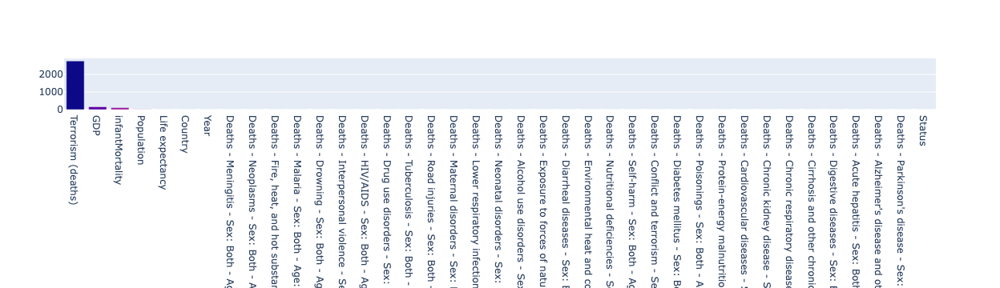

In [ ]:
nan_vals = get_nan_vals(df)
X = list(nan_vals.keys())
Y = list(nan_vals.values())
plot_nan_vals(X,Y)

In [ ]:
df=df.drop('Terrorism (deaths)',axis=1)

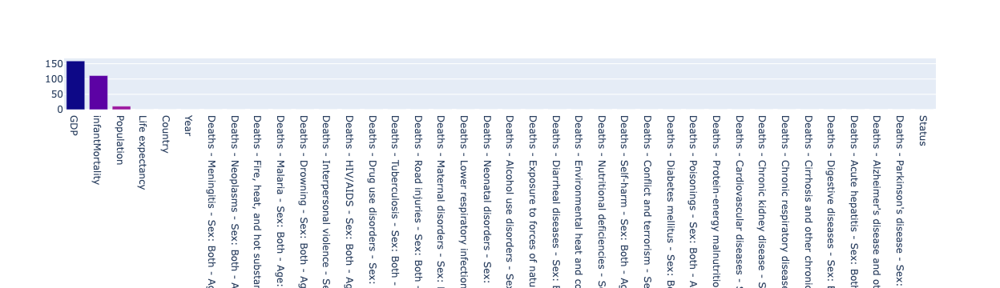

In [ ]:
nan_vals = get_nan_vals(df)
X = list(nan_vals.keys())
Y = list(nan_vals.values())
plot_nan_vals(X,Y)

# Fill with mean

In [ ]:
df['GDP'].mean()

10666.68771380657

In [ ]:
df['GDP']=df['GDP'].fillna(df['GDP'].mean())

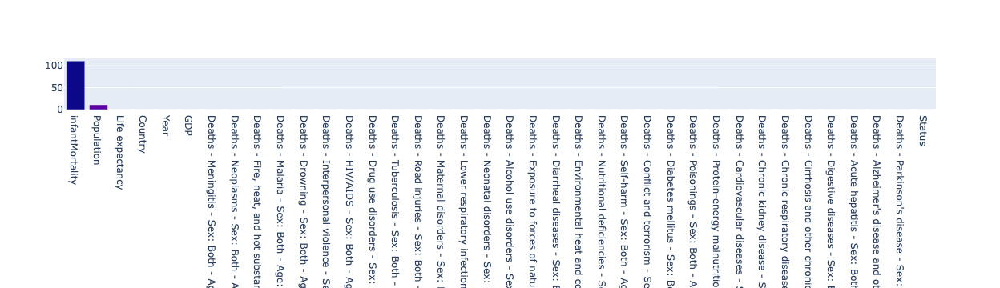

In [ ]:
nan_vals = get_nan_vals(df)
X = list(nan_vals.keys())
Y = list(nan_vals.values())
plot_nan_vals(X,Y)

In [ ]:
df['infantMortality']=df['infantMortality'].fillna(df['infantMortality'].mean())

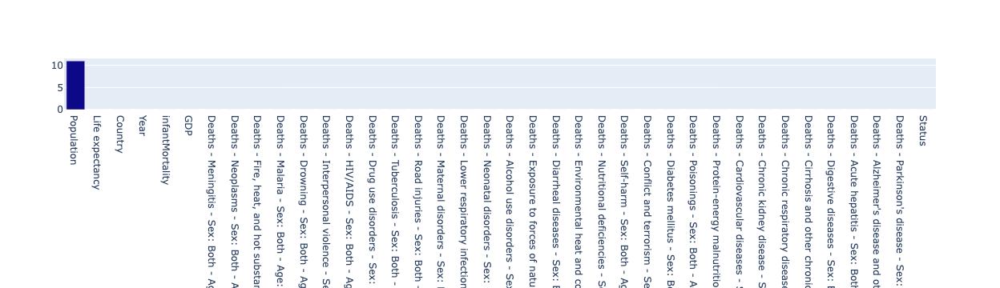

In [ ]:
nan_vals = get_nan_vals(df)
X = list(nan_vals.keys())
Y = list(nan_vals.values())
plot_nan_vals(X,Y)

# Forward Fill for population

In [ ]:
df['Population']=df['Population'].fillna(method='ffill')

In [ ]:
df

,Life expectancy,Country,Year,infantMortality,Population,GDP,Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",Deaths - Malaria - Sex: Both - Age: All Ages (Number),...,Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number),Status
0,59.375,Afghanistan,2007,71.9,27100542.0,359.693158,2933.0,15925.0,481.0,393.0,...,2439.0,53962.0,4490.0,7222.0,3346.0,6458.0,3437.0,1402.0,450.0,Developing
1,59.930,Afghanistan,2008,69.2,27722281.0,364.663542,2731.0,16148.0,462.0,255.0,...,2231.0,54051.0,4534.0,7143.0,3316.0,6408.0,3005.0,1424.0,455.0,Developing
2,60.484,Afghanistan,2009,66.7,28394806.0,437.268740,2460.0,16383.0,448.0,239.0,...,1998.0,53964.0,4597.0,7045.0,3291.0,6358.0,2663.0,1449.0,460.0,Developing
3,61.553,Afghanistan,2011,61.8,30117411.0,591.190030,2327.0,17094.0,448.0,390.0,...,1805.0,54347.0,4785.0,6916.0,3318.0,6370.0,2365.0,1508.0,473.0,Developing
4,62.054,Afghanistan,2012,59.5,31161378.0,638.845852,2254.0,17522.0,445.0,94.0,...,1667.0,54868.0,4846.0,6878.0,3353.0,6398.0,2264.0,1544.0,482.0,Developing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5102,59.534,Zimbabwe,2015,42.1,13814642.0,1445.069702,1439.0,11161.0,632.0,2518.0,...,2990.0,16649.0,2108.0,2751.0,1956.0,4202.0,146.0,754.0,215.0,Developing
5103,60.294,Zimbabwe,2016,40.8,14030338.0,1464.588957,1457.0,11465.0,648.0,2050.0,...,3027.0,16937.0,2160.0,2788.0,1962.0,4264.0,146.0,767.0,219.0,Developing
5104,60.812,Zimbabwe,2017,39.9,14236599.0,1235.189032,1460.0,11744.0,654.0,2116.0,...,2962.0,17187.0,2196.0,2818.0,2007.0,4342.0,144.0,781.0,223.0,Developing
5105,61.195,Zimbabwe,2018,38.8,14438812.0,1254.642265,1450.0,12038.0,657.0,2088.0,...,2890.0,17460.0,2240.0,2849.0,2030.0,4377.0,139.0,795.0,227.0,Developing


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4912 entries, 0 to 5106
Data columns (total 38 columns):
 #   Column                                                                                    Non-Null Count  Dtype  
---  ------                                                                                    --------------  -----  
 0   Life expectancy                                                                           4912 non-null   float64
 1   Country                                                                                   4912 non-null   object 
 2   Year                                                                                      4912 non-null   int64  
 3   infantMortality                                                                           4912 non-null   float64
 4   Population                                                                                4912 non-null   float64
 5   GDP                                                    

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
numerics = ['int8','int16', 'int32', 'int64', 'float16', 'float32', 'float64']
numerical_cols = data.select_dtypes(include=numerics)

In [ ]:
df.columns

Index(['Life expectancy', 'Country', 'Year', 'infantMortality', 'Population',
       'GDP', 'Deaths - Meningitis - Sex: Both - Age: All Ages (Number)',
       'Deaths - Neoplasms - Sex: Both - Age: All Ages (Number)',
       'Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)',
       'Deaths - Malaria - Sex: Both - Age: All Ages (Number)',
       'Deaths - Drowning - Sex: Both - Age: All Ages (Number)',
       'Deaths - Interpersonal violence - Sex: Both - Age: All Ages (Number)',
       'Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number)',
       'Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number)',
       'Deaths - Road injuries - Sex: Both - Age: All Ages (Number)',
       'Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Lower respiratory infections - Sex: Both - Age: All Ages (Number)',
       'Deaths - Neonatal disorders - Sex: Both 

In [ ]:
operation_dic = {}
for i in numerical_cols.columns.values:
    operation_dic[i] = "sum"
for i in ['Life expectancy', 'Year', 'infantMortality', 'Population',
       'GDP', 'Deaths - Meningitis - Sex: Both - Age: All Ages (Number)',
       'Deaths - Neoplasms - Sex: Both - Age: All Ages (Number)',
       'Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)',
       'Deaths - Malaria - Sex: Both - Age: All Ages (Number)',
       'Deaths - Drowning - Sex: Both - Age: All Ages (Number)',
       'Deaths - Interpersonal violence - Sex: Both - Age: All Ages (Number)',
       'Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number)',
       'Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number)',
       'Deaths - Road injuries - Sex: Both - Age: All Ages (Number)',
       'Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Lower respiratory infections - Sex: Both - Age: All Ages (Number)',
       'Deaths - Neonatal disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Alcohol use disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Exposure to forces of nature - Sex: Both - Age: All Ages (Number)',
       'Deaths - Diarrheal diseases - Sex: Both - Age: All Ages (Number)',
       'Deaths - Environmental heat and cold exposure - Sex: Both - Age: All Ages (Number)',
       'Deaths - Nutritional deficiencies - Sex: Both - Age: All Ages (Number)',
       'Deaths - Self-harm - Sex: Both - Age: All Ages (Number)',
       'Deaths - Conflict and terrorism - Sex: Both - Age: All Ages (Number)',
       'Deaths - Diabetes mellitus - Sex: Both - Age: All Ages (Number)',
       'Deaths - Poisonings - Sex: Both - Age: All Ages (Number)',
       'Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number)',
       'Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number)',
       'Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number)',
       'Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number)',
       'Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number)',
       'Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number)',
       'Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number)',
       "Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number)",
       "Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)"
       ]:
    operation_dic[i] = "mean"
del operation_dic["Year"]

In [ ]:
numerical_features = numerical_cols.groupby(by='Year').agg(operation_dic).reset_index()
numerical_features.head(n=25)

,Year,Life expectancy,infantMortality,Population,GDP,Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",Deaths - Malaria - Sex: Both - Age: All Ages (Number),Deaths - Drowning - Sex: Both - Age: All Ages (Number),...,Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number),Terrorism (deaths),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)
0,1990,64.537689,50.651875,2.917348e+07,5555.220794,2503.104294,31709.625767,643.539877,4580.263804,2611.901840,...,3852.423313,6484.0,63412.036810,3321.963190,17931.588957,5522.693252,10274.239264,958.098160,3105.883436,820.509202
1,1991,64.749184,49.616875,2.952939e+07,5727.468096,2467.628049,32285.201220,644.262195,4651.280488,2561.201220,...,3681.792683,7974.0,64177.432927,3381.658537,18173.146341,5581.743902,10366.500000,948.067073,3221.304878,839.335366
2,1992,64.831550,48.667500,3.014514e+07,5788.136378,2470.656442,33011.656442,647.963190,4662.036810,2524.613497,...,3553.754601,8208.0,65174.012270,3486.490798,18601.441718,5688.871166,10539.067485,946.306748,3359.024540,863.779141
3,1993,64.848201,48.009434,3.081068e+07,5529.512132,2452.728395,33965.895062,652.882716,4718.123457,2510.450617,...,3440.141975,0.0,66708.382716,3595.271605,19009.932099,5834.333333,10750.098765,942.462963,3513.833333,896.351852
4,1994,65.005284,47.440881,3.128430e+07,5858.816803,2409.549383,34585.827160,656.450617,4672.203704,2484.827160,...,3317.500000,6241.0,67330.888889,3691.111111,19154.382716,5928.790123,10863.203704,928.154321,3641.672840,917.549383
5,1995,65.189183,45.885625,3.155648e+07,6676.909036,2372.257669,35110.134969,648.963190,4678.699387,2437.631902,...,3171.355828,5529.0,67798.343558,3777.049080,19156.417178,5982.349693,10902.190184,909.822086,3750.987730,939.404908
6,1996,65.374517,44.927044,3.221936e+07,6855.708056,2437.432099,35970.364198,647.765432,4760.049383,2385.444444,...,3049.481481,6315.0,69034.783951,3926.993827,19476.500000,6094.537037,11058.518519,893.290123,3900.419753,975.487654
7,1997,65.686472,43.402484,3.233658e+07,6670.045970,2310.792683,36320.530488,642.798780,4828.006098,2311.597561,...,2881.243902,10571.0,69511.341463,4047.670732,19516.902439,6121.597561,11080.682927,874.060976,3981.750000,999.048780
8,1998,65.792157,42.637736,3.315395e+07,6674.689524,2295.907407,37355.129630,640.246914,4939.709877,2302.814815,...,2774.833333,4440.0,70679.679012,4250.388889,19858.382716,6258.080247,11284.067901,871.000000,4144.376543,1041.648148
9,1999,66.026869,41.233750,3.340785e+07,6799.619236,2260.404908,37948.251534,633.803681,4866.380368,2221.085890,...,2621.539877,2701.0,71230.165644,4377.625767,19827.214724,6299.607362,11317.073620,850.411043,4246.613497,1070.607362


In [ ]:
import seaborn as sns

IndexError: index 7 is out of bounds for axis 0 with size 7

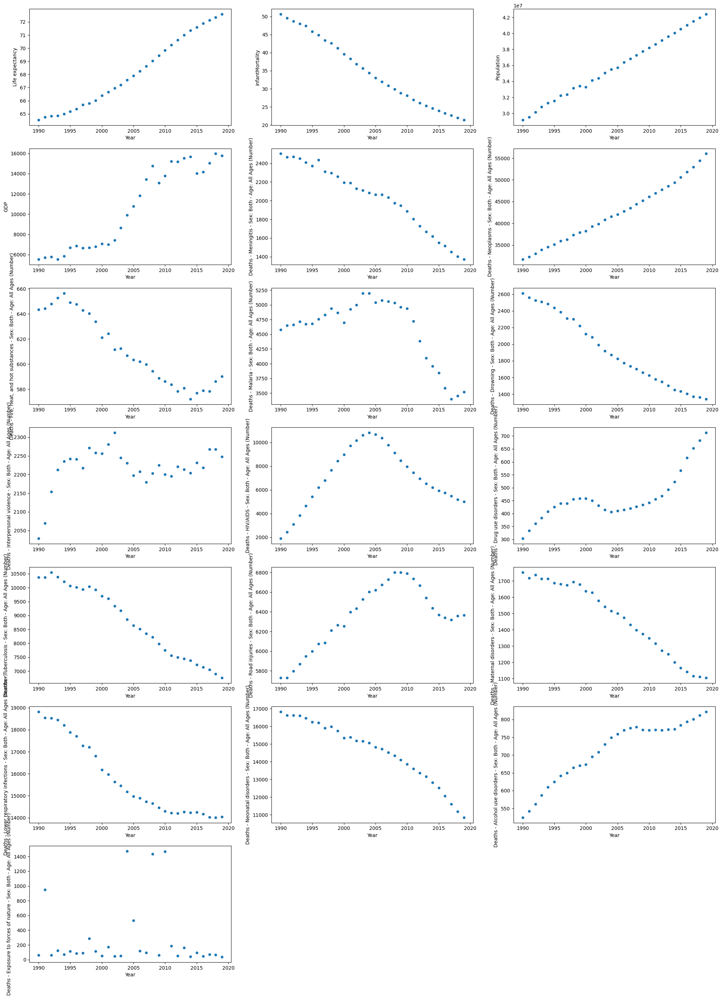

In [ ]:
import math
fig, ax = plt.subplots(nrows=7, ncols=3, figsize=(25, 35))
fig.delaxes(ax[6][1])
fig.delaxes(ax[6][2])
target = numerical_features.pop("Year")
for index, cols in enumerate(numerical_features.columns.values):
    sns.scatterplot(data =numerical_features,  y = cols , x = target , ax = ax[math.floor(index/3)][index%3])
plt.show()

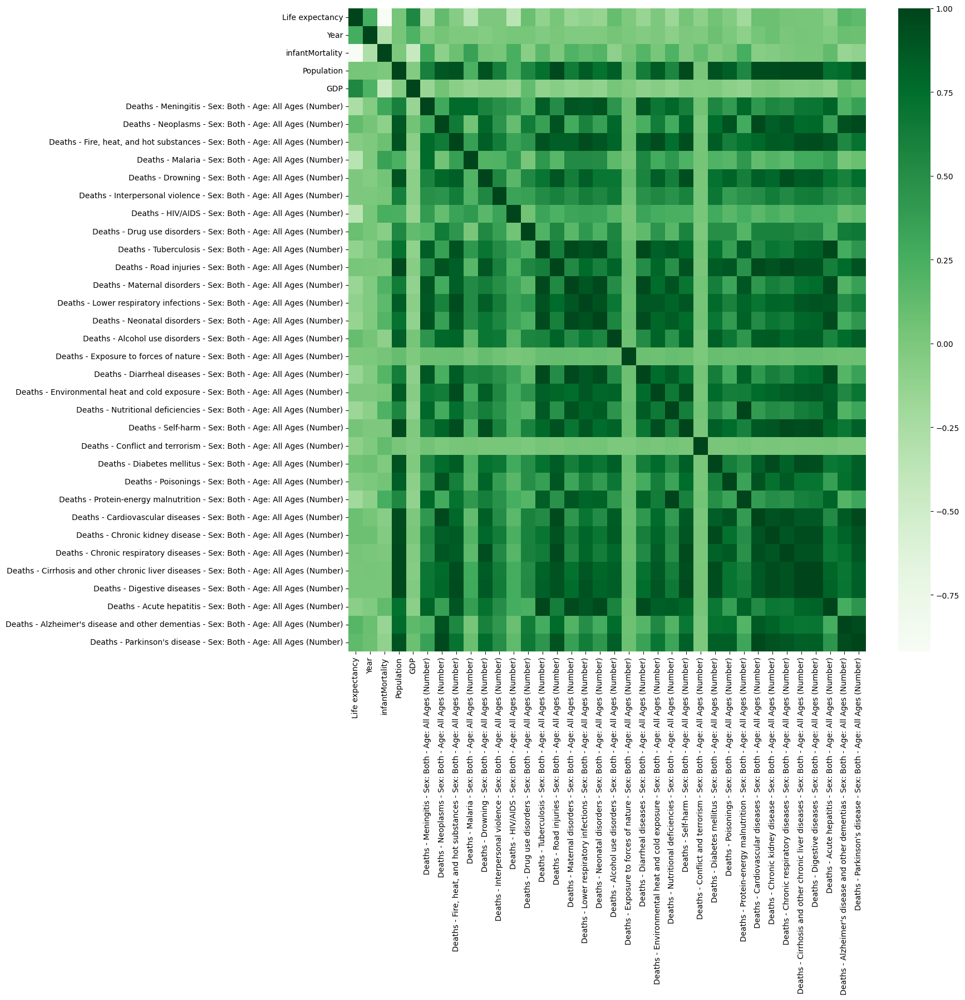

In [ ]:
plt.figure(figsize=(15,15),)
sns.heatmap(df.corr(),  cmap="Greens")
plt.show()

In [ ]:
from scipy import stats
data=df.copy()

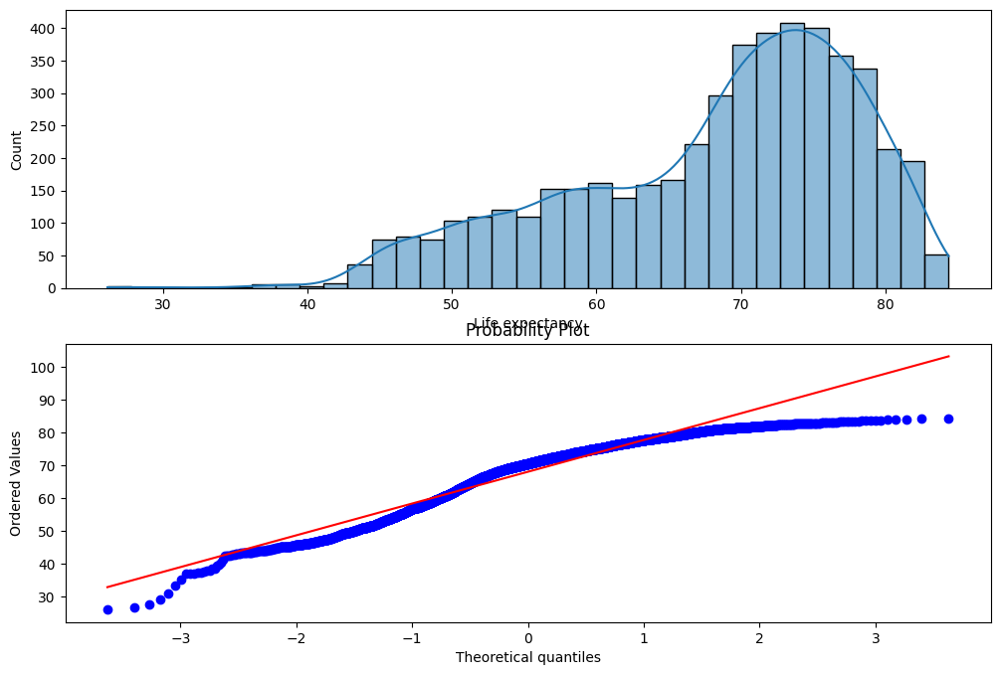

In [ ]:
target = data["Life expectancy"]
plot , ax = plt.subplots(2, figsize = (12 , 8))
g = sns.histplot(target , kde = True, ax = ax[0] )
res = stats.probplot(target, plot=ax[1])

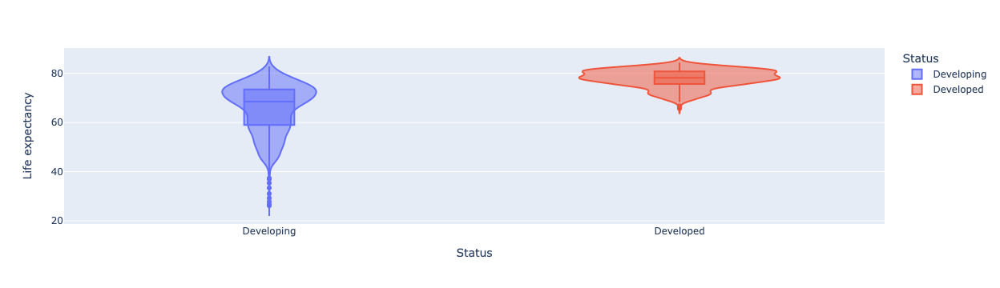

In [ ]:
import plotly.express as px
fig=px.violin(data,x='Status',y='Life expectancy',color='Status',box=True)
fig.show()

In [ ]:
numerical_features = data.copy()

In [ ]:
countries = numerical_features["Country"].unique()   
def make_scatter_plot_country_wise(feature):
    first_title = countries[0]
    traces = []
    buttons = []
    frame = []

    for index,country in enumerate(countries):
        visible = [False] * len(countries)
        visible[index] = True
        name = country
        # Get the dataFrame curresponding to that country
        country_data = numerical_features.query('Country == @country')
        
        traces.append(
            px.scatter(country_data, x=feature, y="Life expectancy", color="Year").update_traces(visible=True if index==0 else False).data[0]
        )
        
        buttons.append(dict(label=name,
                            method="update",
                            args=[{"visible":visible}, {"title":f"{name}"}]))

    fig = go.Figure(data=traces)
    fig.update_layout( xaxis_title=f"<b>{feature}</b>",
                        yaxis_title="<b>Life Expectancy</b>",
                        legend_title="Year",
                        updatemenus=[go.layout.Updatemenu(
                            active=0,
                            buttons=buttons
                            )
                        ])
    fig.update_traces(marker_size=40)

    fig.update_layout(title=f"<b>{feature}</b>")
    fig.show()


In [ ]:
numerical_features.columns.values


array(['Life expectancy', 'Country', 'Year', 'infantMortality',
       'Population', 'GDP',
       'Deaths - Meningitis - Sex: Both - Age: All Ages (Number)',
       'Deaths - Neoplasms - Sex: Both - Age: All Ages (Number)',
       'Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)',
       'Deaths - Malaria - Sex: Both - Age: All Ages (Number)',
       'Deaths - Drowning - Sex: Both - Age: All Ages (Number)',
       'Deaths - Interpersonal violence - Sex: Both - Age: All Ages (Number)',
       'Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number)',
       'Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number)',
       'Deaths - Road injuries - Sex: Both - Age: All Ages (Number)',
       'Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number)',
       'Deaths - Lower respiratory infections - Sex: Both - Age: All Ages (Number)',
       'Deaths - Neonatal disorders - Sex

Life expectancy
Country
Year


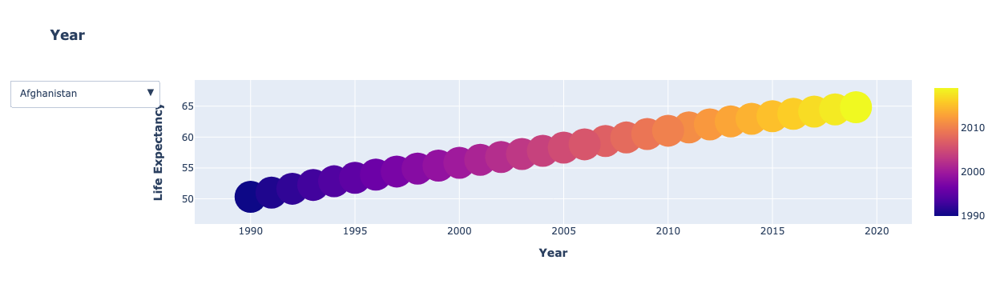

infantMortality


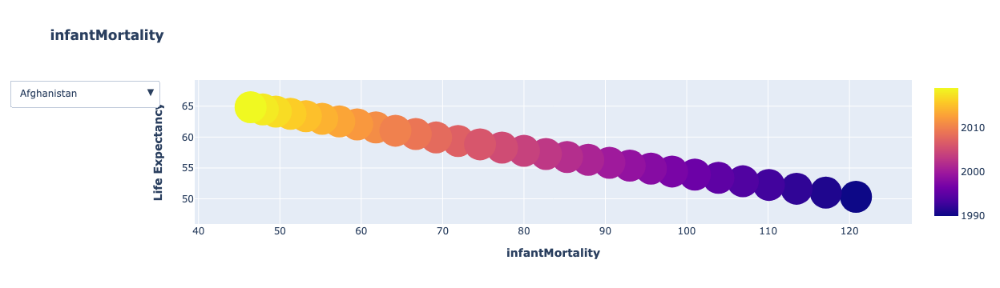

Population


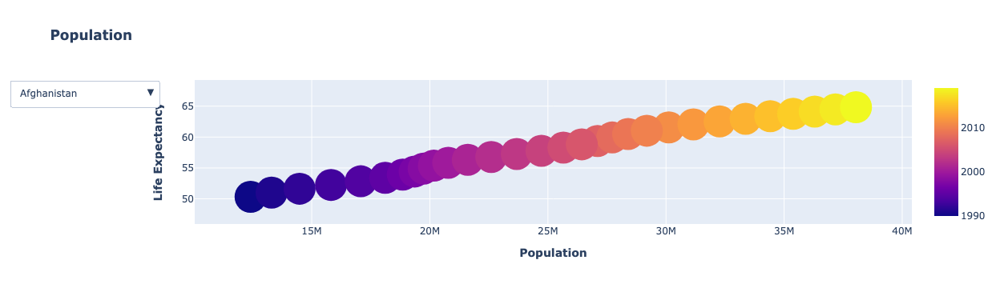

GDP


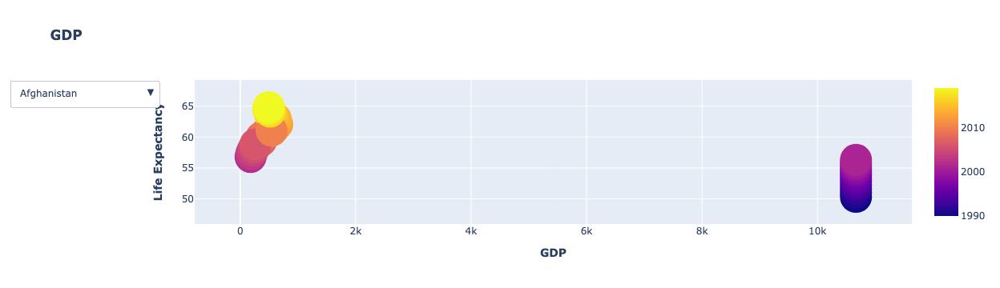

Deaths - Meningitis - Sex: Both - Age: All Ages (Number)


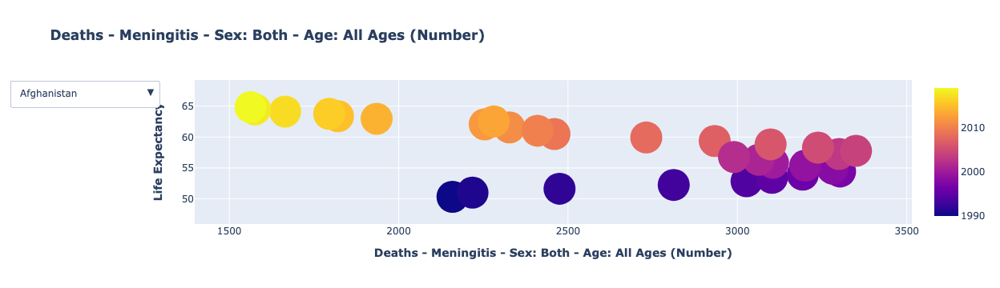

Deaths - Neoplasms - Sex: Both - Age: All Ages (Number)


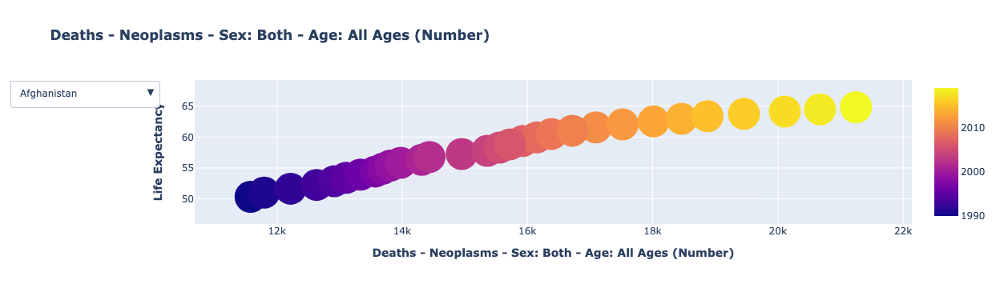

Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)


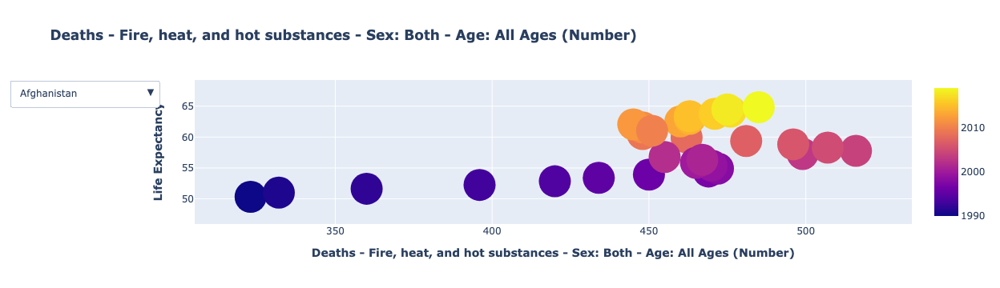

Deaths - Malaria - Sex: Both - Age: All Ages (Number)


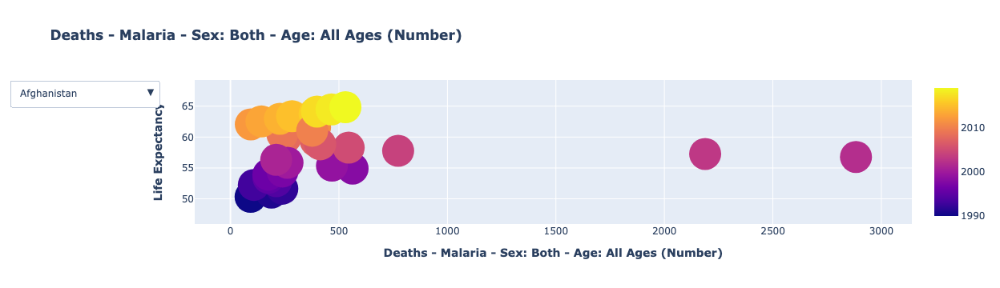

Deaths - Drowning - Sex: Both - Age: All Ages (Number)


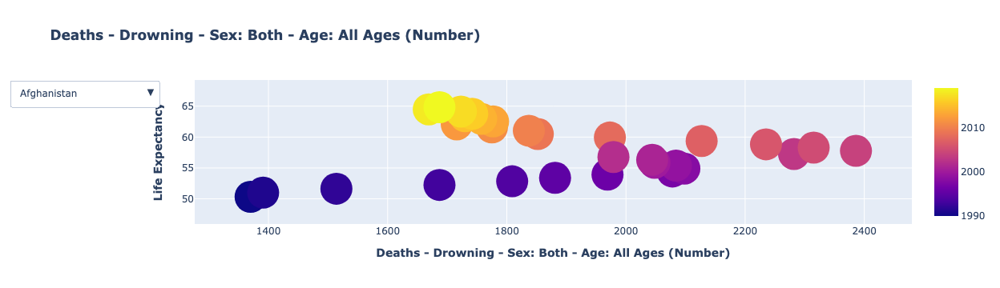

Deaths - Interpersonal violence - Sex: Both - Age: All Ages (Number)


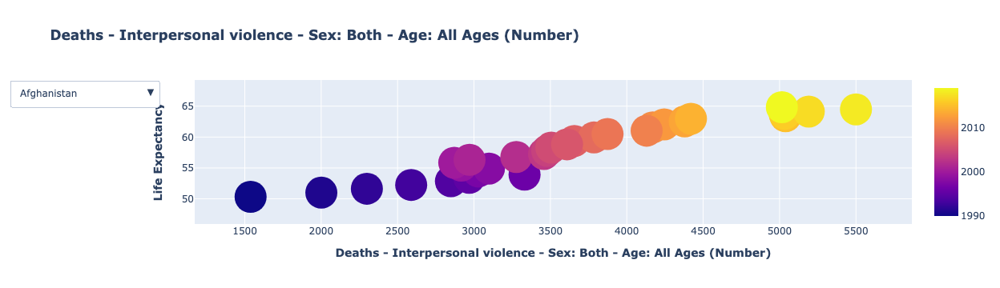

Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number)


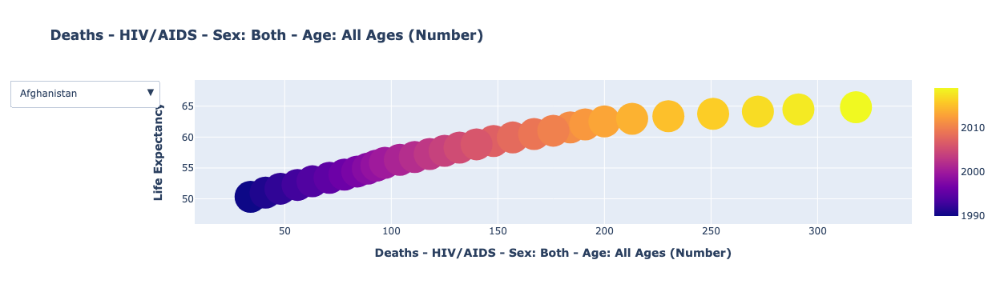

Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number)


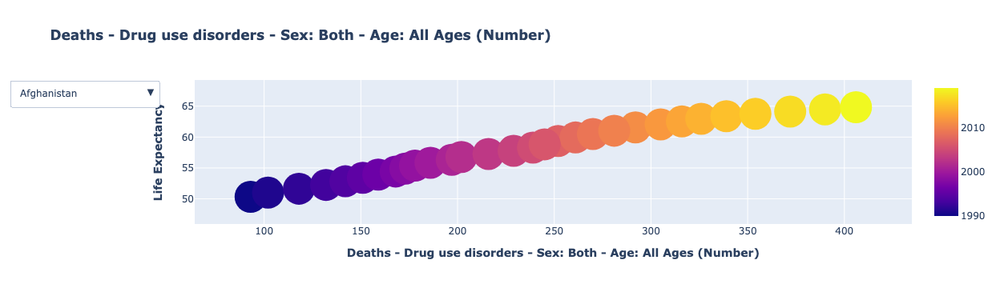

Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number)


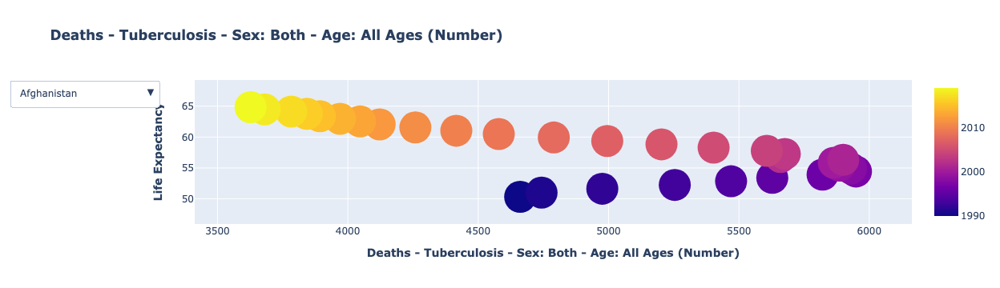

Deaths - Road injuries - Sex: Both - Age: All Ages (Number)


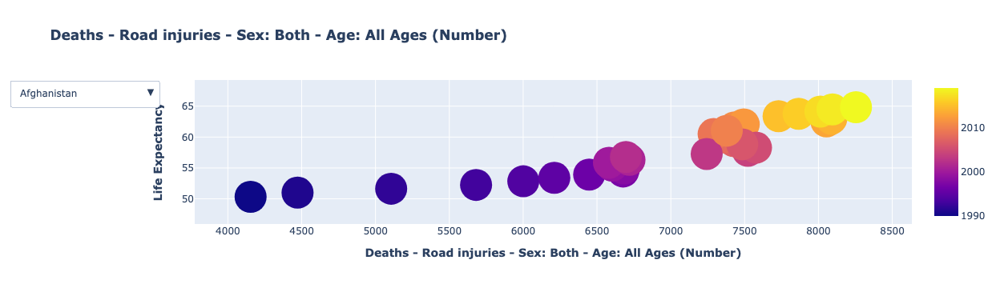

Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number)


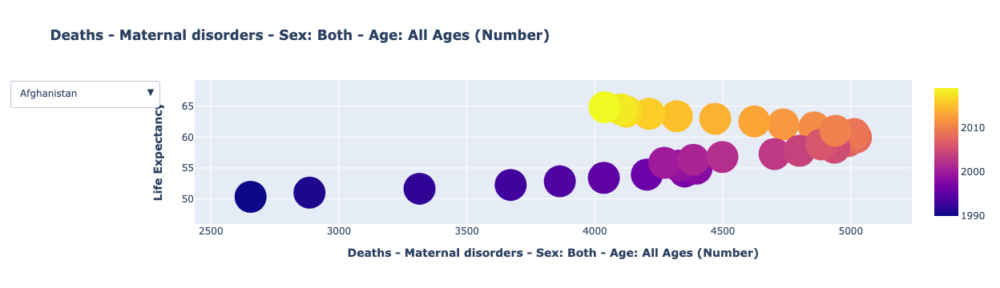

Deaths - Lower respiratory infections - Sex: Both - Age: All Ages (Number)


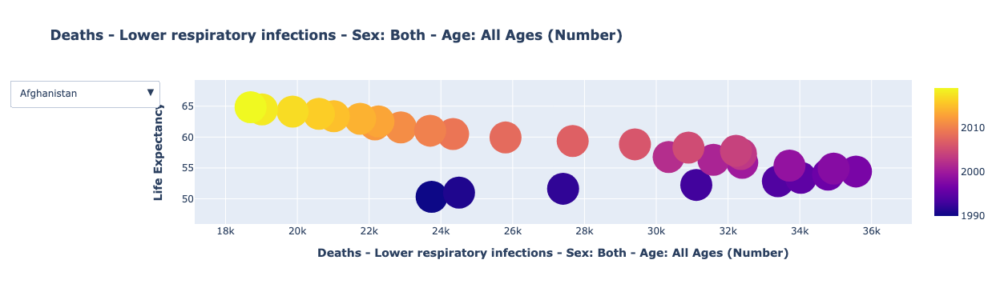

Deaths - Neonatal disorders - Sex: Both - Age: All Ages (Number)


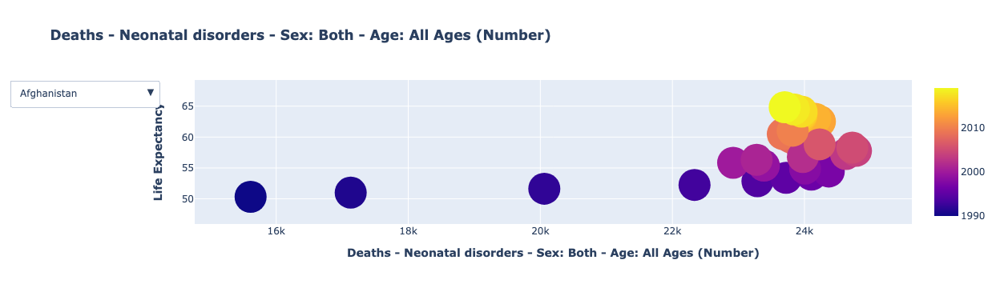

Deaths - Alcohol use disorders - Sex: Both - Age: All Ages (Number)


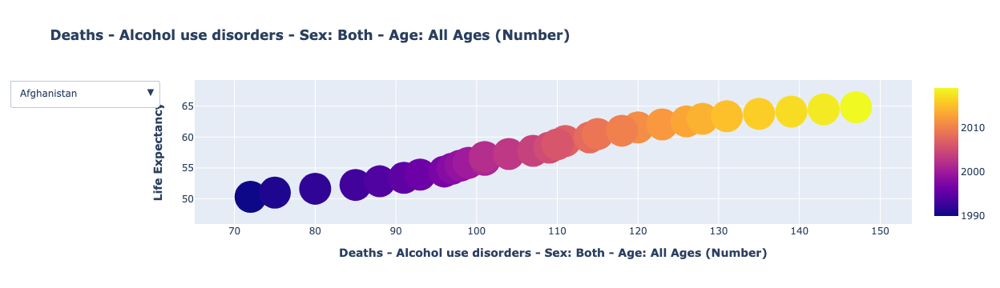

Deaths - Exposure to forces of nature - Sex: Both - Age: All Ages (Number)


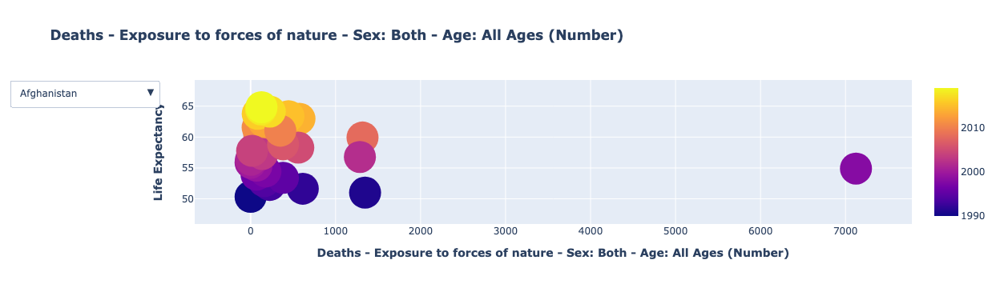

Deaths - Diarrheal diseases - Sex: Both - Age: All Ages (Number)


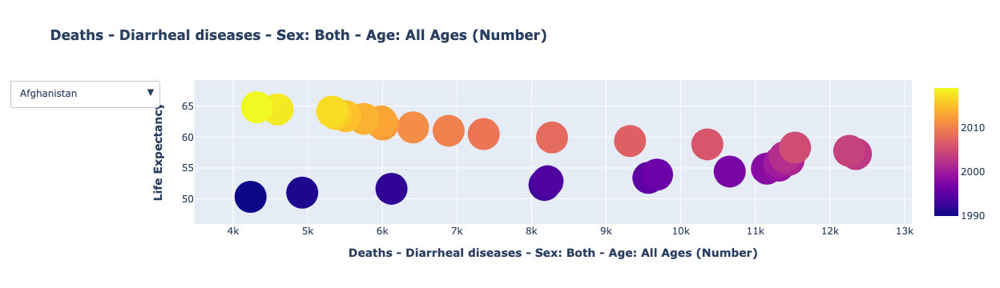

Deaths - Environmental heat and cold exposure - Sex: Both - Age: All Ages (Number)


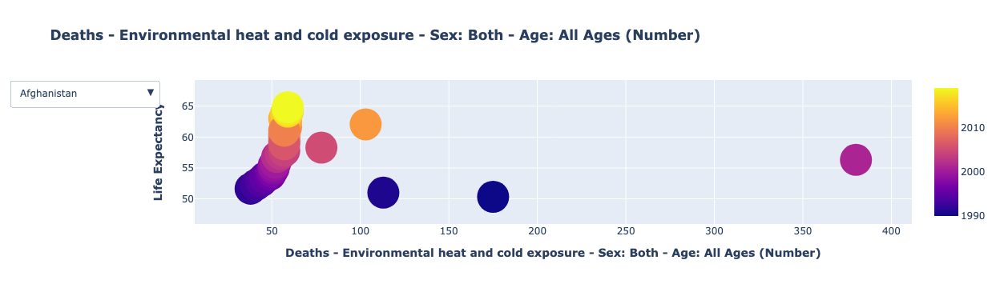

Deaths - Nutritional deficiencies - Sex: Both - Age: All Ages (Number)


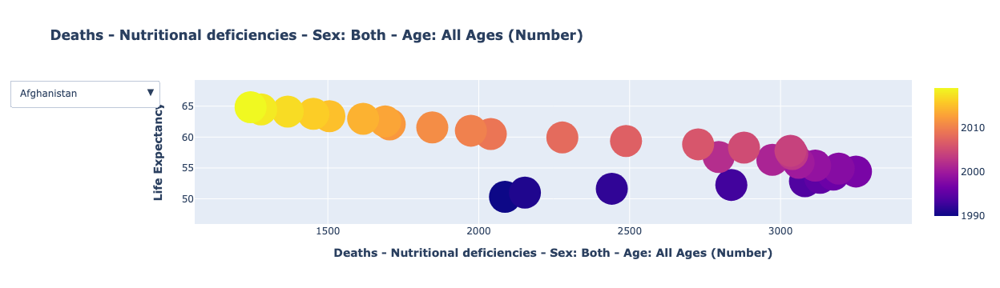

Deaths - Self-harm - Sex: Both - Age: All Ages (Number)


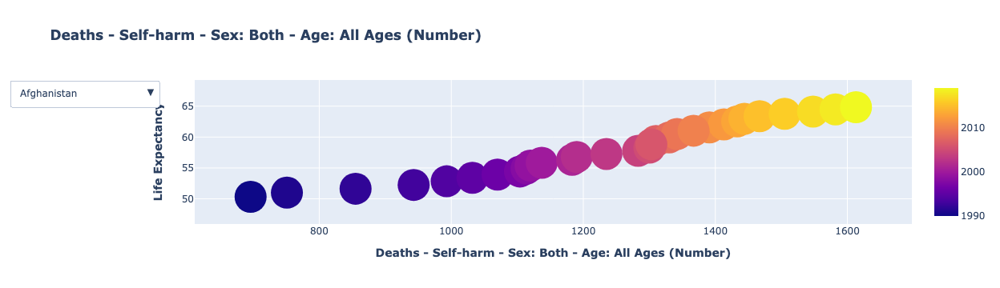

Deaths - Conflict and terrorism - Sex: Both - Age: All Ages (Number)


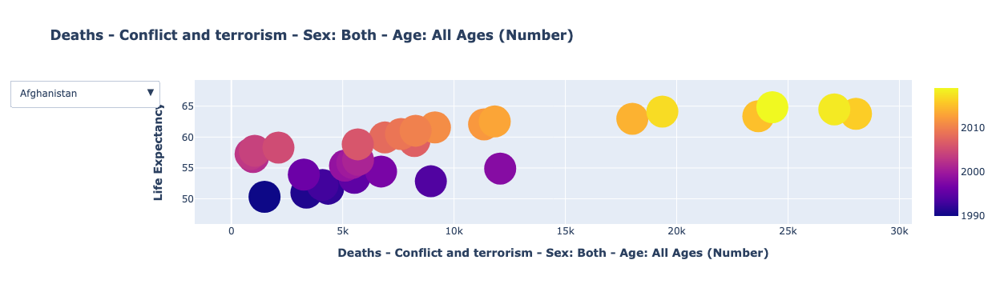

Deaths - Diabetes mellitus - Sex: Both - Age: All Ages (Number)


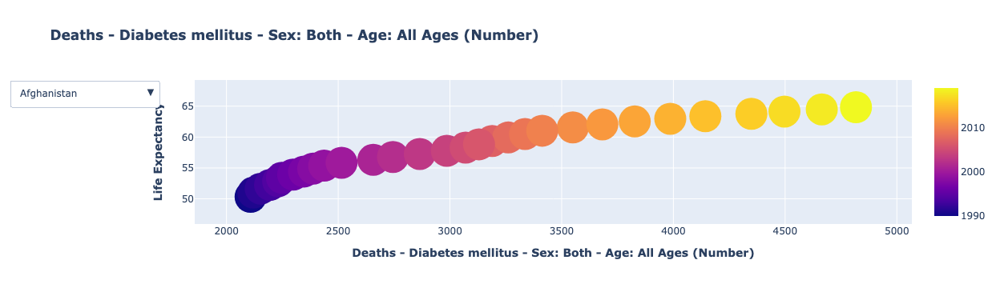

Deaths - Poisonings - Sex: Both - Age: All Ages (Number)


Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number)


Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number)


Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number)


Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number)


Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number)


Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number)


Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number)


Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number)


Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)


Status


In [ ]:
for i in numerical_features.columns.values:
    print(i)
    if i == "Country" or i == "Status" or i == "Life expectancy":
        continue
    make_scatter_plot_country_wise(i)

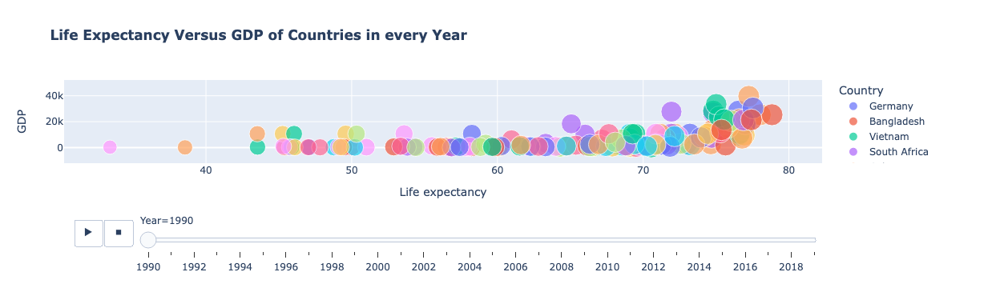

In [ ]:
df2 = data.sort_values(by='Year')
size = list(df2["Life expectancy"])
fig = px.scatter(df2, y='GDP',x='Life expectancy',size=size, animation_frame='Year',animation_group='Country',color='Country',title='<b>Life Expectancy Versus GDP of Countries in every Year')
fig.show()

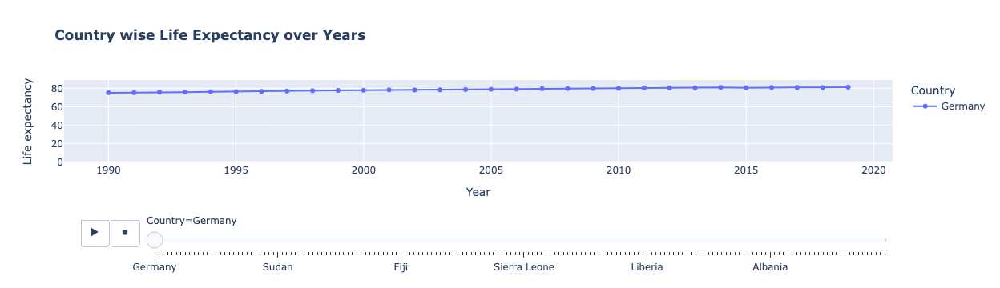

In [ ]:
# Let plot an animated data for every country in case of Life Expectancy by Year
fig=px.line(data.sort_values(by='Year'),x='Year',y='Life expectancy',animation_frame='Country',animation_group='Year',color='Country',markers=True,title='<b> Country wise Life Expectancy over Years')
fig.update_yaxes(range = [-1,89])

fig.show()

In [ ]:
df2=data.drop(['Country','Year','Status'],axis=1)

In [ ]:
# Performing Kolmogorov-Smirnov Test
from scipy.stats import kstest
# df2 = data.iloc[:, 3:]
dic = {"column":[], "statistics":[], "pvalue":[]}
for col in df2.columns.values:
    res = kstest(list(df2[col]), 'norm')
    dic["column"].append(col)
    dic["statistics"].append(res.statistic)
    dic["pvalue"].append(res.pvalue)
pd.DataFrame.from_dict(dic)

,column,statistics,pvalue
0,Life expectancy,1.000000,0.0
1,infantMortality,0.978564,0.0
2,Population,1.000000,0.0
3,GDP,1.000000,0.0
4,Deaths - Meningitis - Sex: Both - Age: All Age...,0.951395,0.0
5,Deaths - Neoplasms - Sex: Both - Age: All Ages...,1.000000,0.0
6,"Deaths - Fire, heat, and hot substances - Sex:...",0.953431,0.0
7,Deaths - Malaria - Sex: Both - Age: All Ages (...,0.500000,0.0
8,Deaths - Drowning - Sex: Both - Age: All Ages ...,0.992950,0.0
9,Deaths - Interpersonal violence - Sex: Both - ...,0.984603,0.0


In [ ]:
n_cols = data.select_dtypes(include=numerics)


In [ ]:
# Now Let's scale the data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

scaler.fit(n_cols)


StandardScaler()

In [ ]:
n_cols

,Life expectancy,Year,infantMortality,Population,GDP,Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",Deaths - Malaria - Sex: Both - Age: All Ages (Number),Deaths - Drowning - Sex: Both - Age: All Ages (Number),...,Deaths - Poisonings - Sex: Both - Age: All Ages (Number),Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)
0,59.375,2007,71.9,27100542.0,359.693158,2933.0,15925.0,481.0,393.0,2127.0,...,513.0,2439.0,53962.0,4490.0,7222.0,3346.0,6458.0,3437.0,1402.0,450.0
1,59.930,2008,69.2,27722281.0,364.663542,2731.0,16148.0,462.0,255.0,1973.0,...,495.0,2231.0,54051.0,4534.0,7143.0,3316.0,6408.0,3005.0,1424.0,455.0
2,60.484,2009,66.7,28394806.0,437.268740,2460.0,16383.0,448.0,239.0,1852.0,...,483.0,1998.0,53964.0,4597.0,7045.0,3291.0,6358.0,2663.0,1449.0,460.0
3,61.553,2011,61.8,30117411.0,591.190030,2327.0,17094.0,448.0,390.0,1775.0,...,483.0,1805.0,54347.0,4785.0,6916.0,3318.0,6370.0,2365.0,1508.0,473.0
4,62.054,2012,59.5,31161378.0,638.845852,2254.0,17522.0,445.0,94.0,1716.0,...,482.0,1667.0,54868.0,4846.0,6878.0,3353.0,6398.0,2264.0,1544.0,482.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5102,59.534,2015,42.1,13814642.0,1445.069702,1439.0,11161.0,632.0,2518.0,770.0,...,381.0,2990.0,16649.0,2108.0,2751.0,1956.0,4202.0,146.0,754.0,215.0
5103,60.294,2016,40.8,14030338.0,1464.588957,1457.0,11465.0,648.0,2050.0,801.0,...,393.0,3027.0,16937.0,2160.0,2788.0,1962.0,4264.0,146.0,767.0,219.0
5104,60.812,2017,39.9,14236599.0,1235.189032,1460.0,11744.0,654.0,2116.0,818.0,...,398.0,2962.0,17187.0,2196.0,2818.0,2007.0,4342.0,144.0,781.0,223.0
5105,61.195,2018,38.8,14438812.0,1254.642265,1450.0,12038.0,657.0,2088.0,825.0,...,400.0,2890.0,17460.0,2240.0,2849.0,2030.0,4377.0,139.0,795.0,227.0


In [ ]:
norm_df = pd.DataFrame(scaler.transform(n_cols)).rename(columns=dict(zip([i for i in range(0,len(n_cols))],[x for x in n_cols.columns])))
norm_df.head()

,Life expectancy,Year,infantMortality,Population,GDP,Deaths - Meningitis - Sex: Both - Age: All Ages (Number),Deaths - Neoplasms - Sex: Both - Age: All Ages (Number),"Deaths - Fire, heat, and hot substances - Sex: Both - Age: All Ages (Number)",Deaths - Malaria - Sex: Both - Age: All Ages (Number),Deaths - Drowning - Sex: Both - Age: All Ages (Number),...,Deaths - Poisonings - Sex: Both - Age: All Ages (Number),Deaths - Protein-energy malnutrition - Sex: Both - Age: All Ages (Number),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Acute hepatitis - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)
0,-0.875722,0.286583,1.145540,-0.062947,-0.615035,0.123147,-0.148299,-0.059022,-0.215529,0.020980,...,0.036430,0.028570,-0.077972,-0.049069,-0.110290,-0.149710,-0.134296,0.580925,-0.204948,-0.173580
1,-0.820203,0.402205,1.062009,-0.058434,-0.614739,0.095747,-0.147048,-0.067641,-0.222630,0.005306,...,0.027904,0.004366,-0.077688,-0.046654,-0.110965,-0.151043,-0.135522,0.488221,-0.203852,-0.172599
2,-0.764783,0.517826,0.984666,-0.053552,-0.610406,0.058989,-0.145730,-0.073991,-0.223453,-0.007010,...,0.022220,-0.022746,-0.077966,-0.043197,-0.111802,-0.152153,-0.136749,0.414830,-0.202607,-0.171617
3,-0.657846,0.749070,0.833072,-0.041049,-0.601221,0.040948,-0.141743,-0.073991,-0.215684,-0.014848,...,0.022220,-0.045204,-0.076742,-0.032880,-0.112904,-0.150954,-0.136454,0.350881,-0.199669,-0.169066
4,-0.607729,0.864692,0.761916,-0.033472,-0.598378,0.031047,-0.139342,-0.075352,-0.230914,-0.020853,...,0.021746,-0.061262,-0.075077,-0.029532,-0.113229,-0.149399,-0.135767,0.329207,-0.197876,-0.167300


In [ ]:
y = norm_df.pop("Life expectancy").values
X = norm_df.values

In [ ]:
#  Cross Validation Approach
def cv_rmse(model, X=norm_df , Y=y):
    rmse = np.sqrt(-cross_val_score(model,X, Y, scoring="neg_mean_squared_error", cv=kf))
    return (rmse)

In [ ]:
# Lets use the stats model API to get the values for the p-value
import statsmodels.api as sm
mod = sm.OLS(y, X)
res = mod.fit()
print(res.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.909
Model:                            OLS   Adj. R-squared (uncentered):              0.908
Method:                 Least Squares   F-statistic:                              1391.
Date:                Tue, 27 Sep 2022   Prob (F-statistic):                        0.00
Time:                        22:52:58   Log-Likelihood:                         -1084.8
No. Observations:                4912   AIC:                                      2240.
Df Residuals:                    4877   BIC:                                      2467.
Df Model:                          35                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [ ]:
# Let's apply lasso regularizer to see which features are important
from sklearn.linear_model import Lasso
clf  = Lasso(alpha=0.1)

clf.fit(X, y)

Lasso(alpha=0.1)

In [ ]:
clf.coef_ #Let's see the different values of coefficient to get a sense if data

array([ 0.        , -0.75304699,  0.        ,  0.1187409 ,  0.        ,
        0.        ,  0.        , -0.        ,  0.        ,  0.        ,
       -0.057715  ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        , -0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ])

In [ ]:
from sklearn.svm import SVR
from sklearn.feature_selection import RFE
# Now let's use sklearn backward selection algorithm
# Let's use State Vector Machine as a estimator to for the model with a linear kernel'


In [ ]:
estimator = SVR(kernel="linear")
selector = RFE(estimator, n_features_to_select=1, step=1)

In [ ]:
selector = selector.fit(X, y)
ranking = selector.ranking_

In [ ]:
dic = {"columns":[], "ranking":[]}
for index, col in enumerate(norm_df.columns):
    dic["columns"].append(col)

    dic["ranking"].append(ranking[index])

In [ ]:
select_df = pd.DataFrame(dic)


In [ ]:
select_df

,columns,ranking
0,Year,34
1,infantMortality,1
2,Population,23
3,GDP,2
4,Deaths - Meningitis - Sex: Both - Age: All Age...,32
5,Deaths - Neoplasms - Sex: Both - Age: All Ages...,26
6,"Deaths - Fire, heat, and hot substances - Sex:...",29
7,Deaths - Malaria - Sex: Both - Age: All Ages (...,18
8,Deaths - Drowning - Sex: Both - Age: All Ages ...,10
9,Deaths - Interpersonal violence - Sex: Both - ...,30


In [ ]:
select_df.sort_values(by=['ranking'])

,columns,ranking
1,infantMortality,1
3,GDP,2
10,Deaths - HIV/AIDS - Sex: Both - Age: All Ages ...,3
34,Deaths - Parkinson's disease - Sex: Both - Age...,4
27,Deaths - Cardiovascular diseases - Sex: Both -...,5
16,Deaths - Neonatal disorders - Sex: Both - Age:...,6
14,Deaths - Maternal disorders - Sex: Both - Age:...,7
13,Deaths - Road injuries - Sex: Both - Age: All ...,8
29,Deaths - Chronic respiratory diseases - Sex: B...,9
8,Deaths - Drowning - Sex: Both - Age: All Ages ...,10


In [ ]:
col_to_drop=list(select_df.sort_values(by=['ranking'])['columns'])[24:]

In [ ]:
cleaned_df = norm_df.drop(col_to_drop, axis=1)


In [ ]:
cleaned_df

,infantMortality,Population,GDP,Deaths - Malaria - Sex: Both - Age: All Ages (Number),Deaths - Drowning - Sex: Both - Age: All Ages (Number),Deaths - HIV/AIDS - Sex: Both - Age: All Ages (Number),Deaths - Drug use disorders - Sex: Both - Age: All Ages (Number),Deaths - Tuberculosis - Sex: Both - Age: All Ages (Number),Deaths - Road injuries - Sex: Both - Age: All Ages (Number),Deaths - Maternal disorders - Sex: Both - Age: All Ages (Number),...,Deaths - Nutritional deficiencies - Sex: Both - Age: All Ages (Number),Deaths - Diabetes mellitus - Sex: Both - Age: All Ages (Number),Deaths - Poisonings - Sex: Both - Age: All Ages (Number),Deaths - Cardiovascular diseases - Sex: Both - Age: All Ages (Number),Deaths - Chronic kidney disease - Sex: Both - Age: All Ages (Number),Deaths - Chronic respiratory diseases - Sex: Both - Age: All Ages (Number),Deaths - Cirrhosis and other chronic liver diseases - Sex: Both - Age: All Ages (Number),Deaths - Digestive diseases - Sex: Both - Age: All Ages (Number),Deaths - Alzheimer's disease and other dementias - Sex: Both - Age: All Ages (Number),Deaths - Parkinson's disease - Sex: Both - Age: All Ages (Number)
0,1.145540,-0.062947,-0.615035,-0.215529,0.020980,-0.298766,-0.066847,-0.085963,0.040558,0.524776,...,-0.004846,-0.142222,0.036430,-0.077972,-0.049069,-0.110290,-0.149710,-0.134296,-0.204948,-0.173580
1,1.062009,-0.058434,-0.614739,-0.222630,0.005306,-0.298377,-0.063995,-0.090639,0.037918,0.529250,...,-0.023673,-0.138336,0.027904,-0.077688,-0.046654,-0.110965,-0.151043,-0.135522,-0.203852,-0.172599
2,0.984666,-0.053552,-0.610406,-0.223453,-0.007010,-0.297945,-0.061143,-0.095451,0.035467,0.528206,...,-0.044820,-0.134288,0.022220,-0.077966,-0.043197,-0.111802,-0.152153,-0.136749,-0.202607,-0.171617
3,0.833072,-0.041049,-0.601221,-0.215684,-0.014848,-0.297210,-0.054170,-0.102750,0.040822,0.504938,...,-0.062131,-0.122739,0.022220,-0.076742,-0.032880,-0.112904,-0.150954,-0.136454,-0.199669,-0.169066
4,0.761916,-0.033472,-0.598378,-0.230914,-0.020853,-0.296907,-0.050051,-0.105874,0.043161,0.486890,...,-0.074712,-0.115615,0.021746,-0.075077,-0.029532,-0.113229,-0.149399,-0.135767,-0.197876,-0.167300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4907,0.223604,-0.159380,-0.550269,-0.106191,-0.117141,0.955386,-0.113751,0.055876,-0.149972,-0.017411,...,0.042535,-0.142923,-0.026095,-0.197221,-0.179789,-0.148484,-0.211456,-0.189633,-0.237220,-0.219698
4908,0.183385,-0.157815,-0.549104,-0.130271,-0.113985,0.868027,-0.111849,0.050950,-0.147596,-0.019947,...,0.045837,-0.138444,-0.020411,-0.196300,-0.176936,-0.148168,-0.211189,-0.188112,-0.236572,-0.218913
4909,0.155542,-0.156318,-0.562793,-0.126875,-0.112255,0.768824,-0.110265,0.045567,-0.146201,-0.023825,...,0.039948,-0.135529,-0.018043,-0.195501,-0.174960,-0.147912,-0.209190,-0.186199,-0.235875,-0.218128
4910,0.121511,-0.154850,-0.561632,-0.128316,-0.111543,0.650385,-0.108363,0.040618,-0.144843,-0.026510,...,0.033523,-0.131860,-0.017095,-0.194629,-0.172545,-0.147647,-0.208169,-0.185340,-0.235178,-0.217343


In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin
class Scrape_data_country(BaseEstimator, TransformerMixin):
    
    def fit(self, X, y=None):
        return self
    
    def build_df_for_country_population(self, name):
        df = pd.DataFrame()
        if correct_name_dic.get(name) is not None:
            name = correct_name_dic[name]
        r = requests.get(f'https://www.worldometers.info/world-population/{name}-population/')
        soup = BeautifulSoup(r.text,'html.parser')
        year = []
        population = []
        prev = None
        for i in soup.select(".table-responsive table tbody tr"):
            val = i.get_text().split()
            if(prev is not None):
                if val[0] > prev:
                    break
            prev = val[0]
            year.append(val[0]) 
            population.append(val[1])
        df["year"] = [int(i) for i in year]
        df["Population"] = [float(i.replace(',','')) for i in population]
        return df
    
    def transform(self, data):
        # Now we need to search and substitue those missing values in the table 
        curr_country = "afghanistan"
        country_info_df = build_df_for_country_population(curr_country)
        print(data)
        for index, row in data.iterrows():
            if pd.isna(row["Population"]):
                year = row["Year"]
                country = '-'.join([i.lower() for i in row["Country"].split()])
                if curr_country != country:
                    curr_country = country
                    country_info_df = build_df_for_country_population(curr_country)
                # Now it might be possible that the data doesn't exists for that particular country for that year. Take the neares neightbour
                year_lst = list(country_info_df["year"])
                if year in year_lst:
                    val = float(country_info_df.query('year == @year')["Population"])
                    data.loc[index, ["Population"]] = val
                else:
                    lower_bound = year - 5
                    upper_bound = year + 5
                    val = statistics.mean(list(country_info_df.query('@lower_bound < year < @upper_bound')["Population"]))
                    data.loc[index,["Population"]] = val
        return data
    
class Scrape_data_gdp(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    
    def build_df_for_country_GDP(self, name):
        df = pd.DataFrame()
        if correct_name_dic.get(name) is not None:
            name = correct_name_dic[name]
        r = requests.get(f'https://www.worldometers.info/gdp/{name}-gdp/')
        soup = BeautifulSoup(r.text,'html.parser')
        year = []
        gdp = []
        for i in soup.select(".table-responsive table tbody tr"):
            soup2= BeautifulSoup(str(i), 'html.parser')
            val = [txt.get_text() for txt in soup2.select('td')]
            year.append(int(val[0]))
            gdp.append(float(val[4][1:].replace(',', '')))
        df["year"] = year
        df["GDP"] = gdp
        return df
    
    
    def transform(self, data):
        # Now we need to search and substitue those missing values in the table
        curr_country = "afghanistan"
        country_info_df = build_df_for_country_GDP(curr_country)
        gdp_not_available = set()
        print("GDP", data)
        for index, row in data.iterrows():
            if pd.isna(row["GDP"]):
                year = row["Year"]
                country = '-'.join([i.lower() for i in row["Country"].split()])
                if curr_country != country:
                    curr_country = country
                    country_info_df = build_df_for_country_GDP(curr_country)
                # Now it might be possible that the data doesn't exists for that particular country for that year. Take the neares neightbour
                year_lst = list(country_info_df["year"])
                if year in year_lst:
                    val = float(country_info_df.query('year == @year')["GDP"])
                    data.loc[index, ["GDP"]] = val
                else:
                    lower_bound = year - 5
                    upper_bound = year + 5
                    if len(country_info_df) == 0:
                        val = np.nan
                        gdp_not_available.add(curr_country)

                    else:
                        val = statistics.mean(list(country_info_df.query('@lower_bound < year < @upper_bound')["GDP"]))
                    data.loc[index,["GDP"]] = val
        return data


In [ ]:
class Impute_Data_with_median(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    
    def transform(self, data):
        print("Medina", data)
        all_countries = data["Country"].unique()
        for i in all_countries:
            nd = data.query('Country == @i')
            # I expect to see RuntimeWarnings in this block because It may happen that the data is entirely empty
            median_vals = {"Hepatitis B": np.nan, "Total expenditure": np.nan, "Alcohol": np.nan, "Income composition of resources": np.nan, \
                            "Schooling": np.nan, " BMI ": np.nan, " thinness  1-19 years": np.nan, "Polio": np.nan, "Diphtheria ": np.nan, \
                            "Life expectancy ": np.nan, "Adult Mortality": np.nan
                          }
            # median = np.nan
            with warnings.catch_warnings():
                warnings.simplefilter("ignore", category=RuntimeWarning)
                # median = nd["Hepatitis B"].median()
                for key, value in median_vals.items():
                    median_vals[key] = nd[key].median()
            indexes = nd.index.values
            for ind in indexes:
                for key, val in median_vals.items():
                    if pd.isna(data.iloc[ind][key]):
                        median = median_vals[key]
                        data.loc[ind, [key]] = median
        return data
        


In [ ]:
class RemoveNanAndNormalizeAndDropCols(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    
    def transform(self, data):
        print("Remove",data)
        data.dropna(inplace=True)
        n_cols = data.select_dtypes(include=numerics)
        scaler = StandardScaler()
        scaler.fit(n_cols)
        norm_df = pd.DataFrame(scaler.transform(n_cols)).rename(columns={0:"Year", 1:"Life expectancy ", 2:"Adult Mortality", 3:"infant deaths", 4:"Alcohol", 5:"percentage expenditure", 6:"Hepatitis B", 7:"Measles ", 8:" BMI ", 9:"under-five deaths ", 10:"Polio", 11:"Total expenditure", 12:"Diphtheria ", 13:" HIV/AIDS", 14:"GDP", 15:"Population", 16:" thinness  1-19 years", 17:" thinness 5-9 years", 18:"Income composition of resources", 19:"Schooling"})
        y = norm_df.pop("Life expectancy ").values
        X = norm_df.values
        col_to_drop = [' thinness 5-9 years', 'Year', 'Alcohol', 'Population', 'Hepatitis B', 'percentage expenditure',' thinness 5-9 years', ' thinness  1-19 years','Total expenditure']
        cleaned_df = norm_df.drop(col_to_drop, axis=1)
        return cleaned_df, y
        


In [ ]:
from sklearn.pipeline import Pipeline
pipe = Pipeline({
    ("Scrape_country", Scrape_data_country()),
    ("Scrape GDP", Scrape_data_gdp()),
    ("Impute with median", Impute_Data_with_median()),
    ('Feature Selection and Normailization', RemoveNanAndNormalizeAndDropCols())
})

cleaned_df, y= pipe.fit_transform(data.copy())

      Life expectancy      Country  Year  infantMortality  Population  \
0              59.375  Afghanistan  2007             71.9  27100542.0   
1              59.930  Afghanistan  2008             69.2  27722281.0   
2              60.484  Afghanistan  2009             66.7  28394806.0   
3              61.553  Afghanistan  2011             61.8  30117411.0   
4              62.054  Afghanistan  2012             59.5  31161378.0   
...               ...          ...   ...              ...         ...   
5102           59.534     Zimbabwe  2015             42.1  13814642.0   
5103           60.294     Zimbabwe  2016             40.8  14030338.0   
5104           60.812     Zimbabwe  2017             39.9  14236599.0   
5105           61.195     Zimbabwe  2018             38.8  14438812.0   
5106           61.490     Zimbabwe  2019             38.1  14645473.0   

              GDP  Deaths - Meningitis - Sex: Both - Age: All Ages (Number)  \
0      359.693158                           

NameError: name 'np' is not defined

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor 
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import Ridge, RidgeCV
from sklearn.linear_model import ElasticNet, ElasticNetCV
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from xgboost import XGBRegressor

In [ ]:
kf = KFold(n_splits=12, random_state=42, shuffle=True)
scores = {}
# Define error metrics
def rmsle(y, y_pred):
    return np.sqrt(mean_squared_error(y, y_pred))

def cv_rmse(model, X=cleaned_df , Y=y):
    rmse = np.sqrt(-cross_val_score(model,X, Y, scoring="neg_mean_squared_error", cv=kf))
    return (rmse)

In [ ]:
import numpy as np
lasso  = Lasso(alpha=0.1)
score = cv_rmse(lasso)
print("Lasso Model: {:.4f} ({:.4f})".format(score.mean(), score.std()))

Lasso Model: 0.3583 (0.0286)


In [ ]:
decision_tree_model = DecisionTreeRegressor()
score = cv_rmse(decision_tree_model)
print("Decision Tree Model: {:.4f} ({:.4f})".format(score.mean(), score.std()))

Decision Tree Model: 0.1220 (0.0358)


In [ ]:
clf = GridSearchCV(decision_tree_model , {
    "max_depth" : [6,7,8,9,10,11,12],
    "min_samples_split": [6,7,8,9,10],
    "min_samples_leaf" : [5,7,8,9,10]
},verbose = 1)
clf.fit(cleaned_df , y)
clf.best_estimator_

score = cv_rmse(clf.best_estimator_)
print("Decision Tree Model: {:.4f} ({:.4f})".format(score.mean(), score.std()))
scores['decision_tree'] = (score.mean(), score.std())

Fitting 5 folds for each of 175 candidates, totalling 875 fits
Decision Tree Model: 0.2167 (0.0219)


In [ ]:
# Support Vector Regressor
svr = make_pipeline(RobustScaler(), SVR(kernel='linear'))
score = cv_rmse(svr)
print("Support Vector Machine: {:.4f} ({:.4f})".format(score.mean(), score.std()))
scores['Support Vector Machine'] = (score.mean(), score.std())

Support Vector Machine: 0.3043 (0.0273)


In [ ]:
# Elastic Net
from sklearn.linear_model import ElasticNet
regr = ElasticNet(random_state=0)
score = cv_rmse(regr)
print("Elastic Net: {:.4f} ({:.4f})".format(score.mean(), score.std()))
scores['Elastic Net'] = (score.mean(), score.std())

Elastic Net: 0.7516 (0.0310)


In [ ]:
# Gradient Boosting Regressor
gbr = GradientBoostingRegressor(loss='huber',random_state=42)  
score = cv_rmse(gbr)
print("gradient_boosting: {:.4f} ({:.4f})".format(score.mean(), score.std()))
scores['gradient boosting'] = (score.mean(), score.std())

gradient_boosting: 0.1670 (0.0229)


In [ ]:
from sklearn import linear_model


In [ ]:
lm = linear_model.LinearRegression()
score = cv_rmse(lm)
print("linear regression: {:.4f} ({:.4f})".format(score.mean(), score.std()))
scores['linear regression'] = (score.mean(), score.std())

linear regression: 0.3028 (0.0270)


Text(0.5, 1.0, 'Scores of Models')

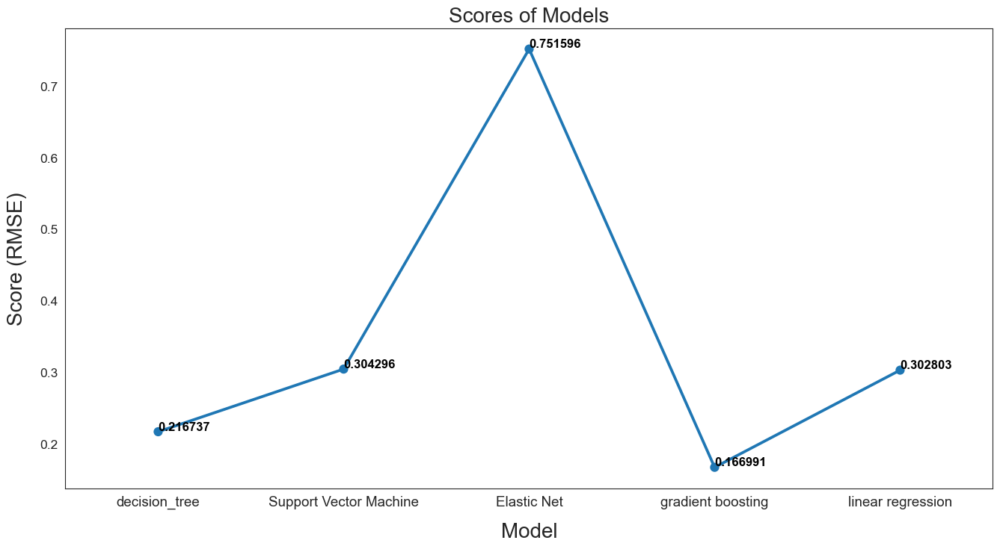

In [ ]:
# Plot the predictions for each model
sns.set_style("white")
fig = plt.figure(figsize=(16, 8))

ax = sns.pointplot(x=list(scores.keys()), y=[score for score, _ in scores.values()], markers=['o'], linestyles=['-'])
for i, score in enumerate(scores.values()):
    ax.text(i, score[0] + 0.002, '{:.6f}'.format(score[0]), horizontalalignment='left', size='large', color='black', weight='semibold')

plt.ylabel('Score (RMSE)', size=20, labelpad=12.5)
plt.xlabel('Model', size=20, labelpad=12.5)
plt.tick_params(axis='x', labelsize=13.5)
plt.tick_params(axis='y', labelsize=12.5)

plt.title('Scores of Models', size=20)